In [10]:
from PIL import Image

from matplotlib import pyplot as plt
from torchvision import datasets

from efficient_b2 import get_model as efficient_get_model
from tiny_vgg import get_model as tiny_get_model
from augmentation import AugmentationV1, AugmentationEfficientnet_b2
from deploy_func import predict, compute_precision, compute_recall, compute_f1

In [6]:
HIDDEN_DATA_PATH = "../data/hidden"

In [3]:
def denormalize(img, mean, std):
    img = img.clone()
    for t, m, s in zip(img, mean, std):
        t.mul_(s).add_(m)
    return img

mean = [0.519, 0.499, 0.469]
std = [0.175, 0.183, 0.197]

# Завантажую найкращу епоху з TinyVGG

In [7]:
model = tiny_get_model('TinyVGG_V1/TinyVGG_V1_epoch_42.pth')

In [8]:
augmantation = AugmentationV1()

hidden_data = datasets.ImageFolder(
                root=HIDDEN_DATA_PATH,
                transform=augmantation.get_test())

CLASS_NAMES = hidden_data.classes

In [11]:
img_path = '../data/test/clean/1001.jpg'
img = Image.open(img_path).convert('RGB')
transform = augmantation.get_test()
img_tensor = transform(img)

predict(img_tensor, model)

(0, 0.7588881850242615)

Hidden dataset count: 219


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9802322e-08..0.8117648].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9802322e-08..0.96470594].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9802322e-08..0.9215687].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9802322e-08..0.9843137].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9802322e-08..0.9764706].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9802322e-08..0.9843138].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for intege

175/219 Accuracy: 79.91%
Precision: 0.8016414046287537
Recall: 0.7988740801811218
F1: 0.7985786199569702


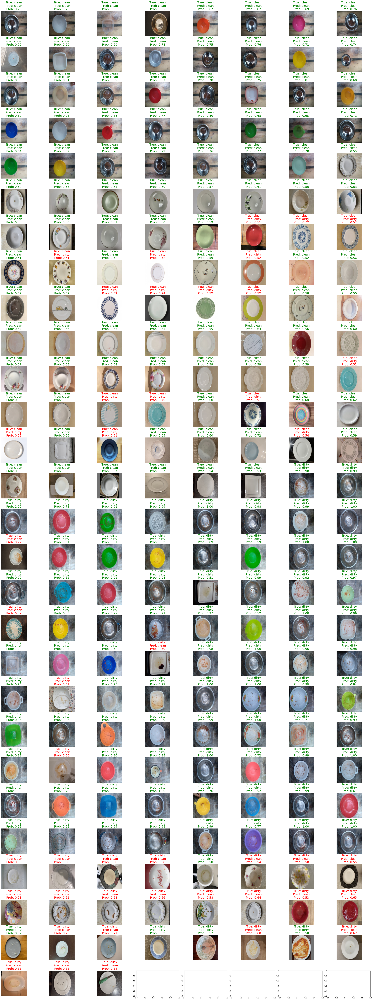

In [13]:
print(f"Hidden dataset count: {len(hidden_data)}")

true_values = []
pred_values = []

n_images = len(hidden_data)
ncols = 8
nrows = (n_images + ncols - 1) // ncols
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 4, nrows * 3))

for i in range(n_images):
    X = hidden_data[i][0]
    y = hidden_data[i][1]
    
    pred_label, pred_prob = predict(X, model)
    true_values.append(y)
    pred_values.append(pred_label)
    
    img_show = denormalize(X, mean, std)
    text = f'True: {CLASS_NAMES[y]}\nPred: {CLASS_NAMES[pred_label]}\nProb: {pred_prob:.2f}'
    color = 'green' if y == pred_label else 'red'
    axs[i // ncols, i % ncols].imshow(img_show.permute(1, 2, 0))
    axs[i // ncols, i % ncols].set_title(text, fontsize=18, color=color)
    axs[i // ncols, i % ncols].axis('off')
plt.tight_layout(pad=0.2)
    
compar_list = [a == b for a, b in zip(true_values, pred_values)]
true_sum = sum(compar_list)
count = len(compar_list)
accuracy = true_sum / count

print(f'{true_sum}/{count} Accuracy: {accuracy:.2%}')
print('Precision:', compute_precision(true_values, pred_values, len(CLASS_NAMES)))
print('Recall:', compute_recall(true_values, pred_values, len(CLASS_NAMES)))
print('F1:', compute_f1(true_values, pred_values, len(CLASS_NAMES)))

# Ті ж самі причини як в тестовому результаті

# Цікавий факт: 
# Оскільки моя фотографія одна з останніх та останні фотографії мають маленьку варіацію -> всі вони від студентів курсу
# Всі ці фотографії від студентів мають невпневненість або неправильний результат, оскільки інші фотографії мають велику варіацію однакових тарілок
# наприклад: алюмінієвий посуд визначає ідеально, оскільки має дуже багато варіацій

# Pretrained model (найкращу епоху)

In [15]:
model = efficient_get_model('EfficientNet/EfficientNet_epoch_26.pth')

In [16]:
augmantation = AugmentationEfficientnet_b2()

hidden_data = datasets.ImageFolder(
                root=HIDDEN_DATA_PATH,
                transform=augmantation.get_test())

CLASS_NAMES = hidden_data.classes

In [17]:
img_path = '../data/test/clean/1001.jpg'
img = Image.open(img_path).convert('RGB')
transform = augmantation.get_test()
img_tensor = transform(img)

predict(img_tensor, model)

(0, 0.9957373142242432)

Hidden dataset count: 219
198/219 Accuracy: 90.41%
Precision: 0.9067376852035522
Recall: 0.9042952656745911
F1: 0.9039814472198486


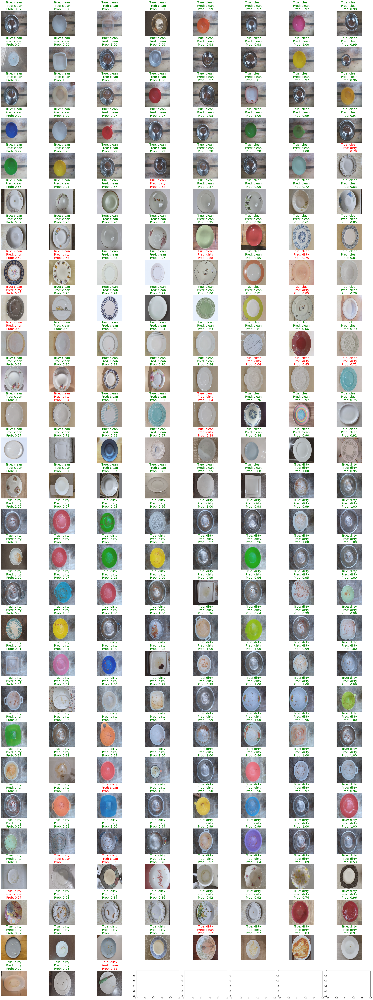

In [18]:
print(f"Hidden dataset count: {len(hidden_data)}")

true_values = []
pred_values = []

n_images = len(hidden_data)
ncols = 8
nrows = (n_images + ncols - 1) // ncols
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 4, nrows * 3))

for i in range(n_images):
    X = hidden_data[i][0]
    y = hidden_data[i][1]
    
    pred_label, pred_prob = predict(X, model)
    true_values.append(y)
    pred_values.append(pred_label)
    
    img_show = denormalize(X, mean, std)
    text = f'True: {CLASS_NAMES[y]}\nPred: {CLASS_NAMES[pred_label]}\nProb: {pred_prob:.2f}'
    color = 'green' if y == pred_label else 'red'
    axs[i // ncols, i % ncols].imshow(img_show.permute(1, 2, 0))
    axs[i // ncols, i % ncols].set_title(text, fontsize=18, color=color)
    axs[i // ncols, i % ncols].axis('off')
plt.tight_layout(pad=0.2)
    
compar_list = [a == b for a, b in zip(true_values, pred_values)]
true_sum = sum(compar_list)
count = len(compar_list)
accuracy = true_sum / count

print(f'{true_sum}/{count} Accuracy: {accuracy:.2%}')
print('Precision:', compute_precision(true_values, pred_values, len(CLASS_NAMES)))
print('Recall:', compute_recall(true_values, pred_values, len(CLASS_NAMES)))
print('F1:', compute_f1(true_values, pred_values, len(CLASS_NAMES)))

# Проблема знову з узорами
# Цікавий факт:
# Майже всі фотографії студентів навчилась вивчати, не дивлячись на те що немає різноманіття даних
# Проблема виникла в ножі, скоріше вивчила його та ще в фотографії де зелений узор та остатки від салату